In [139]:
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import numpy as np
import cv2
from collections import Counter
from skimage.color import rgb2lab, deltaE_cie76
import os

%matplotlib inline

The type of this input is <class 'numpy.ndarray'>
Shape: (256, 192, 3)


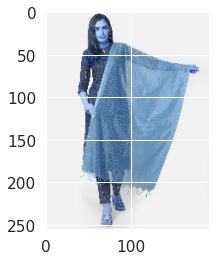

In [140]:
image = cv2.imread('/content/drive/MyDrive/Dress/dressimage.jpg')
print("The type of this input is {}".format(type(image)))
print("Shape: {}".format(image.shape))
plt.imshow(image)


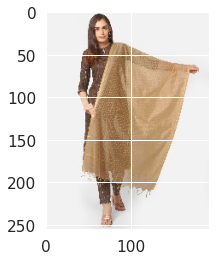

In [141]:
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
plt.imshow(image)

In [142]:
# function that will convert RGB to hex so that we can use them as labels for our pie chart

def RGB2HEX(color):
    return "#{:02x}{:02x}{:02x}".format(int(color[0]), int(color[1]), int(color[2]))

#get an image into Python in the RGB space
def get_image(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [143]:
def get_colors(image, number_of_colors, show_chart):
    
    modified_image = cv2.resize(image, (600, 400), interpolation = cv2.INTER_AREA)
    modified_image = modified_image.reshape(modified_image.shape[0]*modified_image.shape[1], 3)
    
    clf = KMeans(n_clusters = number_of_colors)
    labels = clf.fit_predict(modified_image)
    
    counts = Counter(labels)
    # sort to ensure correct color percentage
    counts = dict(sorted(counts.items()))
    
    center_colors = clf.cluster_centers_
    # We get ordered colors by iterating through the keys
    ordered_colors = [center_colors[i] for i in counts.keys()]
    hex_colors = [RGB2HEX(ordered_colors[i]) for i in counts.keys()]
    rgb_colors = [ordered_colors[i] for i in counts.keys()]

    if (show_chart):
        plt.figure(figsize = (8, 6))
        plt.pie(counts.values(), labels = hex_colors, colors = hex_colors)
    
    return rgb_colors

[array([241.90405514, 241.76990161, 241.65520759]),
 array([164.21148077, 127.00831743,  90.52331606]),
 array([201.27373665, 165.23103203, 127.16      ]),
 array([95.05649844, 66.66279589, 52.77065654]),
 array([179.52901957, 143.89682879, 104.80835969]),
 array([151.7981739 , 113.06964646,  76.40513855]),
 array([114.24783862,  85.82632085,  71.74466859]),
 array([193.73333333, 179.94912281, 168.41461988]),
 array([237.06147705, 200.42035928, 171.19121756]),
 array([140.4800789,  99.4712689,  63.4452334]),
 array([69.65490196, 44.66773619, 32.8171123 ]),
 array([214.78633513, 178.01034217, 140.7662009 ]),
 array([189.32691567, 154.02447879, 115.35051433]),
 array([215.45784225, 211.22937443, 207.59746147]),
 array([233.34801205, 231.85311558, 230.50568679])]

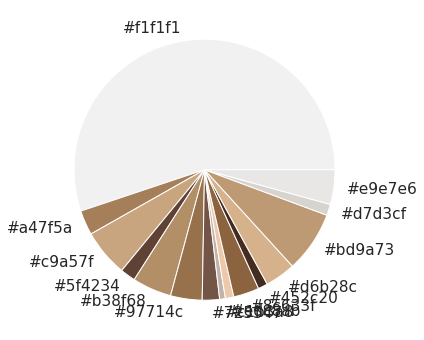

In [147]:
get_colors(get_image('/content/drive/MyDrive/Dress/dressimage.jpg'),15, True)

In [120]:
import numpy as np
import pandas as pd
import os
import cv2
from sklearn.metrics import classification_report
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import tensorflow as tf
from tqdm import tqdm

In [10]:
cloth_data = pd.read_csv("/content/drive/MyDrive/Dress/Myntra_Women_Clothing_Dataset.csv")
cloth_data.drop(['Item_Url', 'Native_Product_Id', 'Primary_Colour'], inplace=True, axis=1)

print(cloth_data)

              Pattern    Print      Fabric  \
0             Checked  Checked  Silk Blend   
1             Checked  Checked  Silk Blend   
2               Woven   Floral  Silk Blend   
3             Checked  Checked  Silk Blend   
4         Embroidered  Striped     Organza   
...               ...      ...         ...   
99995     Embellished      NaN         NaN   
99996           Solid      NaN         NaN   
99997           Solid      NaN         NaN   
99998           Solid      NaN         NaN   
99999  Colour Blocked      NaN         NaN   

                                              Image_Urls  
0      ['https://assets.myntassets.com/assets/images/...  
1      ['https://assets.myntassets.com/assets/images/...  
2      ['https://assets.myntassets.com/assets/images/...  
3      ['https://assets.myntassets.com/assets/images/...  
4      ['https://assets.myntassets.com/assets/images/...  
...                                                  ...  
99995  ['https://assets.myntassets

In [11]:
#take first 70015 from the dataset
cloth_data = cloth_data.iloc[:70015]

print(len(cloth_data))
print(cloth_data)

70015
           Pattern    Print      Fabric  \
0          Checked  Checked  Silk Blend   
1          Checked  Checked  Silk Blend   
2            Woven   Floral  Silk Blend   
3          Checked  Checked  Silk Blend   
4      Embroidered  Striped     Organza   
...            ...      ...         ...   
70010  Embroidered   Floral   Polyester   
70011      Checked  Checked  Silk Blend   
70012        Solid   Floral   Polyester   
70013        Solid    Solid   Polyester   
70014      Checked  Checked  Silk Blend   

                                              Image_Urls  
0      ['https://assets.myntassets.com/assets/images/...  
1      ['https://assets.myntassets.com/assets/images/...  
2      ['https://assets.myntassets.com/assets/images/...  
3      ['https://assets.myntassets.com/assets/images/...  
4      ['https://assets.myntassets.com/assets/images/...  
...                                                  ...  
70010  ['https://assets.myntassets.com/assets/images/...  
70011

In [12]:
cloth_data.isnull().sum()

Pattern       7096
Print         2770
Fabric        7841
Image_Urls       0
dtype: int64

In [13]:
cloth_data = cloth_data.dropna()
print(len(cloth_data))

cloth_data.isnull().sum()

59396


Pattern       0
Print         0
Fabric        0
Image_Urls    0
dtype: int64

In [14]:
cloth_data['Pattern'].unique()

array(['Checked', 'Woven', 'Embroidered', 'Printed', 'Striped', 'Solid',
       'Dyed', 'Colour Blocked', 'Self-Checked', 'Self Design',
       'Yoke Design', 'Embellished', 'Ribbed', 'Washed', 'Lace',
       'Distressed', 'Patterned', 'Hem Design', 'Knitted', 'Faded',
       'Satin Finish'], dtype=object)

In [15]:
cloth_data['Print'].unique()


array(['Checked', 'Floral', 'Striped', 'Ethnic Motifs', 'Abstract Print',
       'Geometric Print', 'Solid', 'Ombre', 'Polka Dots', 'Leheriya',
       'Bandhani', 'Paisley Print', 'Quirky', 'Orange Print',
       'Conversational', 'Graphic Print', 'Self Design',
       'Typographic Print', 'Animal Print', 'Tropical Print',
       'Teal Print', 'Washed', 'Heart Print', 'Panda Print',
       'Captain America', 'Coral Print', 'Camouflage',
       'Mickey Mouse Print', 'Colourblocked', 'Cloud Print',
       'Teddy Bear Print', 'Melange', 'Watermelon Print',
       'Flamingo Print', 'Cat Print', 'Tie & Dye', 'Butterfly Print',
       'Anchor Print', 'Star Print', 'Leopard Print', 'Assorted Print',
       'Harry Potter Print', 'Mauve', 'Tweety Print', 'Leaf Print',
       'Snakeskin Print', 'Minnie Mouse Print', 'Feather Print',
       'Textured', 'Motif', 'Ikat', 'Mughal Boota', 'Embellished',
       'Botanical', 'Other', 'Humour and Comic', 'Open Knit',
       'Cable Knit', 'Alphanumeric',

In [16]:
cloth_data['Fabric'].unique()

array(['Silk Blend', 'Organza', 'Art Silk', 'Pure Cotton', 'Cotton Silk',
       'Cotton Blend', 'Satin', 'Net', 'Poly Chiffon', 'Viscose Rayon',
       'Poly Georgette', 'Poly Crepe', 'Pure Silk', 'Linen', 'Voile',
       'Viscose Georgette', 'Polyester', 'Cotton', 'Nylon', 'Synthetic',
       'Modal', 'Wool Blend', 'Organic Cotton', 'Liva', 'Acetate', 'Silk',
       'Tencel', 'Wool', 'Other', 'Acrylic', 'Pashmina', 'Leather',
       'Fleece', 'Polyviscose', 'PU', 'Suede', 'Polycotton',
       'Polyester PU Coated', 'Synthetic Leather', 'Pure Wool', 'Lyocell',
       'Elastane', 'Georgette', 'Crepe', 'Denim', 'Poly Silk', 'Jacquard',
       'Chiffon', 'Livaeco', 'Pure Chiffon', 'Brasso', 'Pure Georgette',
       'Silk Cotton', 'Jute Silk', 'Pure Linen', 'Linen Blend',
       'Pure Crepe', 'Tissue', 'Supernet', 'Lace', 'Brocade',
       'Jute Cotton', 'Velvet', 'Microfiber', 'Polyamide', 'Bamboo',
       'Chanderi Silk', 'Chanderi Cotton', 'Shantoon', 'Hemp',
       'Dupion Silk', 'Cot

In [17]:
from sklearn import preprocessing

label_encoder = preprocessing.LabelEncoder()

cloth_data['Pattern']= label_encoder.fit_transform(cloth_data['Pattern'])
cloth_data['Print']= label_encoder.fit_transform(cloth_data['Print'])
cloth_data['Fabric']= label_encoder.fit_transform(cloth_data['Fabric'])

cloth_data['Pattern'].unique()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


array([ 0, 19,  5, 11, 17, 16,  3,  1, 15, 14, 20,  4, 12, 18,  9,  2, 10,
        7,  8,  6, 13])

In [18]:
cloth_data['Print'].unique()


array([23, 36, 81, 32,  0, 37, 76, 60, 68, 48,  8, 64, 69, 62, 27, 39, 71,
       91,  4, 89, 84, 95, 41, 65, 20, 28, 18, 53, 26, 25, 85, 52, 96, 35,
       22, 87, 16,  3, 80, 49,  6, 40, 51, 90, 47, 75, 56, 34, 86, 57, 45,
       58, 30, 13, 63, 44, 61, 17,  2, 50, 77, 70, 31, 24,  5, 88, 82, 14,
       43, 21, 98, 46, 29,  1, 94,  9,  7, 55, 15, 93, 54, 83, 19, 38, 59,
       33, 97, 42, 73, 67, 66, 10, 11, 92, 79, 78, 74, 72, 12])

In [19]:
cloth_data['Fabric'].unique()

array([59, 35,  2, 49, 12, 10, 55, 32, 39, 69, 41, 40, 53, 25, 70, 68, 45,
        9, 33, 63, 31, 72, 34, 27,  0, 58, 65, 71, 36,  1, 38, 24, 17, 47,
       37, 61, 44, 46, 64, 54, 29, 16, 18, 13, 14, 42, 20,  8, 28, 48,  4,
       51, 60, 22, 52, 26, 50, 66, 62, 23,  5, 21, 67, 30, 43,  3,  7,  6,
       57, 19, 15, 11, 56])

In [20]:
print(cloth_data.head)

<bound method NDFrame.head of        Pattern  Print  Fabric  \
0            0     23      59   
1            0     23      59   
2           19     36      59   
3            0     23      59   
4            5     81      35   
...        ...    ...     ...   
70010        5     36      45   
70011        0     23      59   
70012       16     36      45   
70013       16     76      45   
70014        0     23      59   

                                              Image_Urls  
0      ['https://assets.myntassets.com/assets/images/...  
1      ['https://assets.myntassets.com/assets/images/...  
2      ['https://assets.myntassets.com/assets/images/...  
3      ['https://assets.myntassets.com/assets/images/...  
4      ['https://assets.myntassets.com/assets/images/...  
...                                                  ...  
70010  ['https://assets.myntassets.com/assets/images/...  
70011  ['https://assets.myntassets.com/assets/images/...  
70012  ['https://assets.myntassets.com/ass

In [21]:
columns = ['Pattern', 'Print', 'Fabric']
cloth_data["allData"] = cloth_data[columns].apply(lambda row: '_'.join(row.values.astype(str)), axis=1)

In [22]:
print(cloth_data.head)

<bound method NDFrame.head of        Pattern  Print  Fabric  \
0            0     23      59   
1            0     23      59   
2           19     36      59   
3            0     23      59   
4            5     81      35   
...        ...    ...     ...   
70010        5     36      45   
70011        0     23      59   
70012       16     36      45   
70013       16     76      45   
70014        0     23      59   

                                              Image_Urls   allData  
0      ['https://assets.myntassets.com/assets/images/...   0_23_59  
1      ['https://assets.myntassets.com/assets/images/...   0_23_59  
2      ['https://assets.myntassets.com/assets/images/...  19_36_59  
3      ['https://assets.myntassets.com/assets/images/...   0_23_59  
4      ['https://assets.myntassets.com/assets/images/...   5_81_35  
...                                                  ...       ...  
70010  ['https://assets.myntassets.com/assets/images/...   5_36_45  
70011  ['https://asse

In [23]:
print(cloth_data['allData'][0])

0_23_59


In [24]:
def search(list, platform):
    for i in range(len(list)):
        if list[i] == platform:
            return True
    return False


class_names = []
for i in range(90000):
  try:
    loopClass = cloth_data['allData'][i]
  except:
    continue

  loopClass = cloth_data['allData'][i]

  if search(class_names, loopClass):
    continue
  else:
    class_names.append(loopClass)



In [25]:
print(class_names)
print(len(class_names))

['0_23_59', '19_36_59', '5_81_35', '0_23_2', '19_32_59', '11_0_59', '11_32_2', '5_37_49', '19_32_12', '11_32_10', '5_76_35', '5_36_59', '11_37_10', '11_32_55', '5_36_32', '5_32_39', '17_81_49', '11_36_59', '19_76_12', '16_76_32', '5_36_39', '16_76_12', '5_32_12', '5_76_59', '3_0_59', '5_37_59', '19_32_2', '11_36_2', '11_32_59', '5_36_35', '19_32_10', '11_32_12', '19_36_2', '16_36_32', '16_76_39', '16_76_35', '11_37_2', '11_0_2', '5_32_10', '3_60_12', '5_32_32', '19_68_2', '0_23_39', '5_36_49', '17_48_49', '5_37_39', '0_76_10', '5_36_10', '17_81_59', '16_76_59', '11_36_49', '3_8_2', '5_64_39', '19_37_69', '5_36_41', '17_81_35', '5_32_35', '5_32_41', '5_36_2', '5_32_49', '5_32_59', '17_81_41', '0_23_69', '5_64_32', '11_8_2', '11_81_59', '19_8_59', '11_69_10', '19_36_10', '3_76_39', '16_76_41', '17_81_10', '19_81_59', '0_23_49', '19_0_12', '17_48_40', '19_64_2', '16_76_40', '19_48_59', '17_81_12', '19_36_12', '19_36_39', '11_48_59', '3_8_59', '5_64_41', '11_69_59', '19_37_59', '5_64_35', 

In [26]:
class_names_label = {class_name:i for i, class_name in enumerate(class_names)}

nb_classes = len(class_names)

print(class_names_label)

{'0_23_59': 0, '19_36_59': 1, '5_81_35': 2, '0_23_2': 3, '19_32_59': 4, '11_0_59': 5, '11_32_2': 6, '5_37_49': 7, '19_32_12': 8, '11_32_10': 9, '5_76_35': 10, '5_36_59': 11, '11_37_10': 12, '11_32_55': 13, '5_36_32': 14, '5_32_39': 15, '17_81_49': 16, '11_36_59': 17, '19_76_12': 18, '16_76_32': 19, '5_36_39': 20, '16_76_12': 21, '5_32_12': 22, '5_76_59': 23, '3_0_59': 24, '5_37_59': 25, '19_32_2': 26, '11_36_2': 27, '11_32_59': 28, '5_36_35': 29, '19_32_10': 30, '11_32_12': 31, '19_36_2': 32, '16_36_32': 33, '16_76_39': 34, '16_76_35': 35, '11_37_2': 36, '11_0_2': 37, '5_32_10': 38, '3_60_12': 39, '5_32_32': 40, '19_68_2': 41, '0_23_39': 42, '5_36_49': 43, '17_48_49': 44, '5_37_39': 45, '0_76_10': 46, '5_36_10': 47, '17_81_59': 48, '16_76_59': 49, '11_36_49': 50, '3_8_2': 51, '5_64_39': 52, '19_37_69': 53, '5_36_41': 54, '17_81_35': 55, '5_32_35': 56, '5_32_41': 57, '5_36_2': 58, '5_32_49': 59, '5_32_59': 60, '17_81_41': 61, '0_23_69': 62, '5_64_32': 63, '11_8_2': 64, '11_81_59': 65, '

In [27]:
IMAGE_SIZE = (150,150)

In [28]:
!mkdir /content/data
!mkdir /content/data/seg_train
!mkdir /content/data/seg_test

In [29]:
for i in range(nb_classes):
  
  os.mkdir('/content/data/seg_train/'+class_names[i])
  os.mkdir('/content/data/seg_test/'+class_names[i])

In [30]:
hi = cloth_data['allData'].value_counts()["19_36_59"]
print(hi)
num = round((hi*20)/100)


202


In [136]:
df = cloth_data.loc[cloth_data['allData'] == "0_0_2"]
listof = df.iat[0,3]
#print(df.iloc[0:1].values)
print(listof)

def Convert(string):
    li = list(string.split("'"))
    li = list(filter(("[").__ne__, li))
    li = list(filter((", ").__ne__, li))
    li = list(filter(("]").__ne__, li))
    return li
  
# Driver code    
str1 = listof
str1 = Convert(str1)
os.path.join("/content/data/seg_train/0_0_2/", str1[0])
print(str1)


['https://assets.myntassets.com/assets/images/14007488/2021/4/15/a720ca45-a260-4c8a-8ac9-a6e5d98fda061618488192957SareesMiteraWomenSareesMiteraWomenSareesMiteraWomenSareesMit1.jpg', 'https://assets.myntassets.com/assets/images/14007488/2021/4/15/ba6d56cd-1712-4574-98e0-e68b25f011ae1618488192983SareesMiteraWomenSareesMiteraWomenSareesMiteraWomenSareesMit3.jpg', 'https://assets.myntassets.com/assets/images/14007488/2021/4/15/993242d3-a8d3-4d73-a83d-540d845264a21618488193013SareesMiteraWomenSareesMiteraWomenSareesMiteraWomenSareesMit4.jpg', 'https://assets.myntassets.com/assets/images/14007488/2021/4/15/3aff22fd-4fdb-4998-a74f-5ae49f2c41ee1618488193050SareesMiteraWomenSareesMiteraWomenSareesMiteraWomenSareesMit5.jpg', 'https://assets.myntassets.com/assets/images/14007488/2021/4/15/e604e13a-92e0-4f4d-9aa8-bfb22364f4a11618488193089SareesMiteraWomenSareesMiteraWomenSareesMiteraWomenSareesMit6.jpg', 'https://assets.myntassets.com/assets/images/14007488/2021/4/15/419d8038-1997-4064-b946-c850d5

In [ ]:
print(df)

       Pattern  Print  Fabric  \
2           19     36      59   
119         19     36      59   
126         19     36      59   
127         19     36      59   
136         19     36      59   
...        ...    ...     ...   
39267       19     36      59   
39281       19     36      59   
39309       19     36      59   
39327       19     36      59   
39463       19     36      59   

                                              Image_Urls   allData  
2      ['https://assets.myntassets.com/assets/images/...  19_36_59  
119    ['https://assets.myntassets.com/assets/images/...  19_36_59  
126    ['https://assets.myntassets.com/assets/images/...  19_36_59  
127    ['https://assets.myntassets.com/assets/images/...  19_36_59  
136    ['https://assets.myntassets.com/assets/images/...  19_36_59  
...                                                  ...       ...  
39267  ['https://assets.myntassets.com/assets/images/...  19_36_59  
39281  ['https://assets.myntassets.com/assets/image

In [133]:
def Convert(string):
    li = list(string.split("'"))
    li = list(filter(("[").__ne__, li))
    li = list(filter((", ").__ne__, li))
    li = list(filter(("]").__ne__, li))
    return li



def split_each_class(nameOfClass):

  frameOfSection = cloth_data.loc[cloth_data['allData'] == nameOfClass]
  cntTrain = 0
  cntTest = 0
  LenInColumn = cloth_data['allData'].value_counts()[nameOfClass]
  split = round((LenInColumn*20)/100)
  #print(frameOfSection, LenInColumn)
  for j in range(LenInColumn):
    #print(df.iat[j,3])
    getImages = df.iat[j,3]
    getImages = Convert(getImages)

    if cntTrain < LenInColumn-split:
      for img in range(len(getImages)):
        os.path.join("/content/data/seg_train/", str(nameOfClass), getImages[img])
      cntTrain+=1
    
    else:
      for img in range(len(getImages)):
        os.path.join("/content/data/seg_test/", str(nameOfClass), getImages[img])
      cntTest+=1

  


for i in range(nb_classes):

  name = class_names[i]

  split_each_class(name)

['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCott

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCot

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCott

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCott

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCot

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCott

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta2.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/f3fe6054-4ccf-44ee-9e58-1b8fc0aad3671628159739866DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta3.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/10d6cac5-47df-4fd8-b596-15f21446e70d1628159740247DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta4.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/80a7bbbd-c520-41b1-8f8e-e4e564b335f81628159740420DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta5.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/6cd3451b-d733-4a34-b1d8-8fbcdb5787d31628159740240DupattaBazaarWomensCheckeredBeigeCott

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Streaming output truncated to the last 5000 lines.
['https://assets.myntassets.com/assets/images/productimage/2019/7/16/d7f1e575-95aa-42ee-b1ec-de0831efee421563255241782-1.jpg', 'https://assets.myntassets.com/assets/images/productimage/2019/7/16/80042440-cce6-4831-840c-6dfc8bfca5c81563255241797-2.jpg', 'https://assets.myntassets.com/assets/images/productimage/2019/7/16/f429da35-616b-4de4-ae7d-8f815b3868321563255241814-3.jpg', 'https://assets.myntassets.com/assets/images/productimage/2019/7/16/989de113-0d17-4538-8cba-313ac975a1ae1563255241829-4.jpg', 'https://assets.myntassets.com/assets/images/productimage/2019/7/16/549ff495-b54d-441c-8d76-686c121e8ca21563255241845-5.jpg']
['https://assets.myntassets.com/assets/images/15038412/2021/8/5/b28b3ea5-c69d-483e-80bf-cb01eeffa7351628159740428DupattaBazaarWomensCheckeredBeigeCottonSilkDupatta1.jpg', 'https://assets.myntassets.com/assets/images/15038412/2021/8/5/d830439b-8e86-4104-a033-516183f61f3b1628159740255DupattaBazaarWomensCheckeredBeigeCo

In [ ]:
def load_data():
  dir = r"/content/data"
  CATEGORY = ["seg_train","seg_test"]

  output = []

  for category in CATEGORY:
    path = os.path.join(dir, category)
    images = []
    labels = []

    for folder in os.listdir(path):
      label = class_names_label[folder]

      for file in os.listdir(os.path.join(folder, folder)):

        img_path = os.path.join(os.path.join(path, folder), file)

        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, IMAGE_SIZE)

        images.append(image)
        labels.append(label)

    images = np.array(images, dtype = 'float32')
    labels = np.array(labels, dtype = 'int32')

  return output

In [ ]:
(train_images, train_labels), (test_images, test_labels) = load_data()
train_images, train_labels = shuffle(train_images, train_labels, random_state=25)

In [ ]:
import keras,os
from keras.models import Model
from keras.layers import Dense, Conv2D, MaxPooling2D , Flatten, Input
from keras.preprocessing.image import image
import numpy as np
from keras.applications.vgg16 import preprocess_input
from keras.applications.vgg16 import VGG16

model = VGG16(weights='imagenet', include_top=False)
model = Model(inputs = model.inputs, outputs = model.layers[-5].output)

In [ ]:
train_features = model.predict(train_images)
test_features = model.predict(test_images)

In [ ]:
model2 = VGG16(weights='imagenet', include_top=False)

input_shape = model2.layers[-4].get_input_shape_at(0)
layer_input = Input(shape = (9,9,512))

x = layer_input
for layer in model2.layers[-4::1]:
  x = layer(x)

x = Conv2D(64, (3,3), activation='relu')(x)
x = MaxPooling2D(pool_size=(2,2))(x)
x= Flatten()(x)
x = Dense(100, activation='relu')(x)
x = Dense(6, activation='softmax')(x)


new_model = Model(layer_input, x)

In [ ]:
new_model.compile(optimizer='adam', loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])

In [ ]:
history = new_model.fit(train_features, train_labels, batch_size =128, epochs = 10, validation_split = 0.2)

In [ ]:
plot_accuracy_loss(history)